# Architectural recovery of the Zeeguu API
- Backend of a web application that supports [free reading in foreign languages](https://zeeguu.org)
- Open source [repository on GH](https://github.com/zeeguu/API/)

# Basic Data Gathering

- extracting basic dependencies between python modules
- every .py file is called a module in Python
- direct relationship between file name and module name
  - file: `./zeeguu_core/model/user.py` <==>
  - module: `zeeguu_core.model.User`

This can easily be adapted to work with another repo.





In [ ]:
# Installing Required Dependencies
import sys
sys.version
!{sys.executable} -m pip install gitpython
!{sys.executable} -m pip install pyvis
!{sys.executable} -m pip install matplotlib
!{sys.executable} -m pip install scipy

In [56]:
# In Collab our notebook runs in a temporary mounted file system
# Let's print the name of the folder where our script runs

import os
cwd = os.getcwd()
print(cwd)


c:\Users\eseme\Desktop\2.semester-CS\Architectural-recovery-SA


In [57]:
# Let's declare a var for the path where we're going to download a repository
# Warning: this must end in /
# On windows this places the folder at C:/content/zeeguu-api/
CODE_ROOT_FOLDER="/content/zeeguu-api/"
CODE_ROOT_CORE="/content/zeeguu-api/zeeguu/core/"
CODE_ROOT_API="/content/zeeguu-api/zeeguu/api/"


In [58]:
from git import Repo
# GitPython is a library that allows us to work easily with git from Python
# https://gitpython.readthedocs.io/en/stable/tutorial.html


# If the file exists, it means we've already downloaded
if not os.path.exists(CODE_ROOT_FOLDER):
  Repo.clone_from("https://github.com/zeeguu/api", CODE_ROOT_FOLDER)


In [59]:
print(CODE_ROOT_FOLDER)

/content/zeeguu-api/


In [60]:
# helper function to get a file path w/o having to always provide the /content/zeeguu-api/ prefix
def file_path(file_name):
    return CODE_ROOT_FOLDER+file_name

assert (file_path("zeeguu/core/model/user.py") == "/content/zeeguu-api/zeeguu/core/model/user.py")


In [61]:
# extracting a module name from a file name
def module_name_from_file_path(full_path):

    # e.g. ../core/model/user.py -> zeeguu.core.model.user

    file_name = full_path[len(CODE_ROOT_FOLDER):]
    file_name = file_name.replace("/__init__.py","")
    file_name = file_name.replace("/",".")
    file_name = file_name.replace(".py","")
    return file_name

assert 'zeeguu.core.model.user' == module_name_from_file_path(file_path('zeeguu/core/model/user.py'))

In [62]:
# naïve way of extracting imports using regular expressions
import re

# Enhanced import detection with full support for various import patterns
def import_from_line(line):
    """
    Extract imported module names from a Python import statement line.
    
    Args:
        line (str): A line of code potentially containing import statement
        
    Returns:
        list: List of imported module names or None if no imports found
    """
    # Remove any comments and trailing whitespace
    line = re.sub(r'#.*$', '', line).strip()
    
    # Skip if empty after comment removal
    if not line:
        return None
        
    # Case 1: from module import ...
    from_match = re.match(r'^from\s+(\S+)\s+import\s+(.+)$', line)
    if from_match:
        base_module = from_match.group(1)
        imported_items = from_match.group(2).split(',')
        
        # For a single import from a module, return that module
        # This maintains compatibility with the original function
        imported_item = imported_items[0].strip()
        
        # Handle 'as' alias
        if ' as ' in imported_item:
            imported_item = imported_item.split(' as ')[0].strip()
            
        # If importing specific attributes/submodules
        if imported_item != '*':
            return base_module
        
        return base_module
    
    # Case 2: import module [as alias], [module2 [as alias2]], ...
    import_match = re.match(r'^import\s+(.+)$', line)
    if import_match:
        modules = import_match.group(1).split(',')
        
        # For a single import, return that module
        # This maintains compatibility with the original function
        module = modules[0].strip()
        
        # Handle 'as' alias
        if ' as ' in module:
            module = module.split(' as ')[0].strip()
            
        return module
        
    return None

# extracts all the imported modules from a file
# returns a module of the form zeeguu_core.model.bookmark, e.g.
def imports_from_file(file):
    all_imports = []
    try:
        with open(file, encoding='utf-8') as f:
            lines = f.readlines()
    #Added the following since there are some of the files that throws a decode error and I cannot be bothered trying to salvage it, 
    # cp437 allows us to continue
    except UnicodeDecodeError:
        # Fallback to cp437 encoding if utf-8 fails
        with open(file, encoding='cp437') as f:
            lines = f.readlines()
            
    # Handle potential multi-line imports and joining them
    joined_lines = []
    current_line = ""
    
    for line in lines:
        line = line.strip()
        if not line or line.startswith('#'):
            # Skip empty lines and full comment lines
            if current_line:
                joined_lines.append(current_line)
                current_line = ""
            continue
            
        if current_line and (line.startswith("import ") or line.startswith("from ")):
            # This is a new import statement
            joined_lines.append(current_line)
            current_line = line
        elif current_line and (line.endswith(",") or "(" in current_line and ")" not in current_line):
            # This is a continuation of a multi-line import
            current_line += " " + line
        elif not current_line and (line.startswith("import ") or line.startswith("from ")):
            # This is the start of an import statement
            current_line = line
        elif current_line:
            # Append to current line
            current_line += " " + line
            if ")" in line and "(" in current_line:
                # End of a multi-line parenthesized import
                joined_lines.append(current_line)
                current_line = ""
                
    # Add the last line if it exists
    if current_line:
        joined_lines.append(current_line)
        
    # Process the joined lines
    for line in joined_lines:
        imp = import_from_line(line)
        if imp:
            all_imports.append(imp)
            
    return all_imports

# Example usage:
# imports_from_file(file_path('zeeguu/core/model/user.py'))
imports_from_file(file_path('zeeguu/core/model/user.py'))

['datetime',
 'json',
 'random',
 're',
 'sqlalchemy.orm',
 'zeeguu.core',
 'sqlalchemy',
 'sqlalchemy.orm',
 'sqlalchemy.orm.exc',
 'zeeguu.core.language.difficulty_estimator_factory',
 'zeeguu.core.model.language',
 'zeeguu.core.model.learning_cycle',
 'zeeguu.logging',
 'zeeguu.core.util',
 'zeeguu.core.model',
 'zeeguu.logging',
 'zeeguu.core.model.user_cohort_map',
 'zeeguu.core.model',
 'zeeguu.core.model.user_preference',
 'zeeguu.core.model',
 'zeeguu.core.model',
 'zeeguu.core.word_scheduling.basicSR.basicSR',
 'zeeguu.core.sql.queries.query_loader',
 'zeeguu.core.sql.query_building',
 'zeeguu.core.model.bookmark',
 'zeeguu.core.word_scheduling.basicSR.basicSR',
 'zeeguu.core.word_scheduling.basicSR.basicSR',
 'zeeguu.core.word_scheduling.basicSR.basicSR',
 'zeeguu.core.word_scheduling.basicSR.basicSR',
 'zeeguu.core.model.user_article',
 'dateutil.relativedelta',
 'zeeguu.core.model.user_cohort_map',
 'zeeguu.core.model',
 'zeeguu.core.model',
 'zeeguu.core.model.user_reading

In [63]:
# test
bookmark_imports = imports_from_file(file_path('zeeguu/core/model/bookmark.py'))
unique_code_imports =  imports_from_file(file_path('zeeguu/core/model/unique_code.py'))
print(bookmark_imports)
print(unique_code_imports)
assert(unique_code_imports != bookmark_imports)

['datetime', 'sqlalchemy', 'sqlalchemy', 'sqlalchemy.orm', 'sqlalchemy.orm.exc', 'zeeguu.core.model.caption', 'zeeguu.core.model.video', 'zeeguu.logging', 'zeeguu.core.bookmark_quality.fit_for_study', 'zeeguu.core.model.article', 'zeeguu.core.model.exercise', 'zeeguu.core.model.exercise_outcome', 'zeeguu.core.model.exercise_source', 'zeeguu.core.model.language', 'zeeguu.core.model.source', 'zeeguu.core.model.text', 'zeeguu.core.model.user', 'zeeguu.core.model.user_word', 'zeeguu.core.model.learning_cycle', 'zeeguu.core.model.bookmark_user_preference', 'zeeguu.core.model.bookmark_context', 'zeeguu.core.model', 'zeeguu.core.util.encoding', 'wordstats', 'zeeguu.core.word_scheduling', 'zeeguu.core.model.context_type', 'zeeguu.core.model.article', 'zeeguu.core.model.video', 'zeeguu.core.model.article_title_context', 'zeeguu.core.model.article_fragment_context', 'zeeguu.core.model.video_title_context', 'zeeguu.core.model.video_caption_context', 'zeeguu.logging', 'zeeguu.core.tokenization', '

# Now we extract the dependencies between all the files

To do that we iterate over all the python files with the help of the `Path.rglob` function from `pathlib`

And we create a network with the help of the `networkx` package.

In [64]:
import pathlib
from pathlib import Path
import networkx as nx

def dependencies_graph(code_root_folder):
    files = Path(code_root_folder).rglob("*.py")

    G = nx.Graph()

    for file in files:
        file_path = str(file)

        module_name = module_name_from_file_path(file_path)

        if module_name not in G.nodes:
            G.add_node(module_name)

        for each in imports_from_file(file_path):
            G.add_edge(module_name, each)

    return G

# Mathplotlib also has support for drawing networks

We do a simple drawing of all the files and their dependencies in our system

In [94]:
import matplotlib.pyplot as plt

# a function to draw a graph
def draw_graph(G: nx.Graph, size, **args):
    plt.figure(figsize=size)
    nx.draw(G, **args)
    plt.show()
    
def draw_largest_connected_component(graph, size, save_path="largest_component.png", dpi=300, draw_labels=False):
    """
    Draw only the largest connected component of a graph with node sizes
    proportional to their cardinality (degree) and save the output.
    
    Parameters:
    graph: A networkx graph object
    save_path: Path to save the output image (default: "largest_component.png")
    dpi: Resolution for the saved image (default: 300)
    
    Returns:
    largest_subgraph: The networkx graph object of the largest component
    """
    import networkx as nx
    import matplotlib.pyplot as plt
    
    # Find all connected components
    connected_components = list(nx.connected_components(graph))
    
    if not connected_components:
        print("The graph has no connected components.")
        return None
    
    # Find the largest component (by number of nodes)
    largest_component = max(connected_components, key=len)
    
    # Extract the subgraph for the largest component
    largest_subgraph = graph.subgraph(largest_component).copy()  # Create a copy
    
    # Calculate node sizes based on degree (cardinality)
    node_degrees = dict(largest_subgraph.degree())
    # Scale node sizes: base size of 300 plus 100 times the degree
    node_sizes = [300 + (node_degrees[node] * 100) for node in largest_subgraph.nodes()]
    
    # Draw the largest component
    plt.figure(figsize=size)
    pos = nx.spring_layout(largest_subgraph, seed=42)  # For consistent layout
    
    # Draw nodes with varying sizes
    nx.draw_networkx_nodes(largest_subgraph, pos, 
                          node_color='skyblue',
                          node_size=node_sizes,)
    
    # Draw edges
    nx.draw_networkx_edges(largest_subgraph, pos, alpha=0.7)
    
    # Draw labels
    if draw_labels:
        nx.draw_networkx_labels(largest_subgraph, pos, font_weight='bold')
    
    plt.title(f"Largest Connected Component ({len(largest_component)} nodes)")
    plt.axis('off')
    
    # Save the figure
    plt.savefig(save_path, dpi=dpi, bbox_inches='tight')
    print(f"Graph saved to {save_path}")
    
    # Display the plot
    plt.show()
    
    # Return the largest subgraph for further use if needed
    return largest_subgraph
def draw_largest_connected_component(graph, size, save_path="largest_component.png", dpi=300, draw_labels=False):
    """
    Draw only the largest connected component of a graph, excluding nodes with degree 1.
    Node sizes are proportional to degree. Saves the image to a file.
    """
    import networkx as nx
    import matplotlib.pyplot as plt

    # Find connected components
    connected_components = list(nx.connected_components(graph))

    if not connected_components:
        print("The graph has no connected components.")
        return None

    # Get the largest component
    largest_component = max(connected_components, key=len)
    largest_subgraph = graph.subgraph(largest_component).copy()

    # Filter out nodes with degree 1
    filtered_nodes = [node for node in largest_subgraph.nodes() if largest_subgraph.degree(node) > 1]
    filtered_subgraph = largest_subgraph.subgraph(filtered_nodes).copy()

    if filtered_subgraph.number_of_nodes() == 0:
        print("No nodes with degree > 1 in the largest connected component.")
        return None

    # Compute node sizes
    node_degrees = dict(filtered_subgraph.degree())
    node_sizes = [300 + (node_degrees[node] * 100) for node in filtered_subgraph.nodes()]

    # Draw the filtered subgraph
    plt.figure(figsize=size)
    pos = nx.spring_layout(filtered_subgraph, seed=42)

    nx.draw_networkx_nodes(filtered_subgraph, pos,
                           node_color='skyblue',
                           node_size=node_sizes)

    nx.draw_networkx_edges(filtered_subgraph, pos, alpha=0.7)

    if draw_labels:
        nx.draw_networkx_labels(filtered_subgraph, pos, font_weight='bold')

    plt.title(f"Largest Component (Nodes with degree > 1 only: {filtered_subgraph.number_of_nodes()})")
    plt.axis('off')
    plt.savefig(save_path, dpi=dpi, bbox_inches='tight')
    print(f"Graph saved to {save_path}")
    plt.show()

    return filtered_subgraph


In [66]:


# ------------------------ Claude generated visualization
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
from matplotlib.cm import get_cmap
from collections import defaultdict


# Original drawing function
def draw_graph(G: nx.Graph, size, **args):
    plt.figure(figsize=size)
    nx.draw(G, **args)
    plt.show()


# Enhanced dependency graph visualization
def visualize_dependencies(G, figsize=(18, 12), title="Code Dependency Graph", 
                           save_path=None, max_nodes_labeled=150, 
                           layout_type="kamada_kawai", group_by_module=True):
    """
    Create an enhanced visualization of a dependency graph.
    
    Args:
        G (nx.Graph): NetworkX graph of dependencies
        figsize (tuple): Figure size as (width, height)
        title (str): Title for the visualization
        save_path (str, optional): Path to save the image, if None, just displays
        max_nodes_labeled (int): Maximum number of nodes to show labels for
        layout_type (str): Layout algorithm to use ('spring', 'kamada_kawai', 'spectral', 'shell')
        group_by_module (bool): Whether to color nodes by top-level module
    
    Returns:
        The figure and positions dictionary
    """
    # Create figure
    fig, ax = plt.subplots(figsize=figsize)
    fig.suptitle(title, fontsize=16)
    
    # Check if the graph is too large
    num_nodes = len(G.nodes())
    if num_nodes > 1000:
        print(f"Warning: Large graph with {num_nodes} nodes. Visualization may be slow and cluttered.")
    
    # Compute node sizes based on importance
    # More connections = larger node
    node_degrees = dict(G.degree())
    # Logarithmic scaling to prevent too large differences
    node_sizes = {node: 50 + 100 * np.log1p(degree) for node, degree in node_degrees.items()}
    
    # Compute layout
    print(f"Computing {layout_type} layout...")
    if layout_type == "spring":
        pos = nx.spring_layout(G, seed=42, k=0.2)  # k controls spacing
    elif layout_type == "kamada_kawai":
        pos = nx.kamada_kawai_layout(G)
    elif layout_type == "spectral":
        pos = nx.spectral_layout(G)
    elif layout_type == "shell":
        pos = nx.shell_layout(G)
    else:
        pos = nx.spring_layout(G, seed=42)
    
    # Group nodes by top-level module if requested
    if group_by_module:
        # Extract top-level module from node name
        module_groups = defaultdict(list)
        for node in G.nodes():
            # Get first part of the module path
            top_module = node.split('.')[0] if '.' in node else node
            module_groups[top_module].append(node)
        
        # Get a colormap with enough colors
        colormap = get_cmap('tab20')  # 20 distinct colors
        colormap2 = get_cmap('Set3')  # Additional 12 colors if needed
        
        # Assign colors to modules
        num_modules = len(module_groups)
        if num_modules > 20:
            # Combine colormaps for more colors
            module_colors = {}
            for i, module in enumerate(module_groups.keys()):
                if i < 20:
                    module_colors[module] = colormap(i / 20)
                else:
                    module_colors[module] = colormap2((i - 20) / 12)
        else:
            module_colors = {module: colormap(i / 20) for i, module in enumerate(module_groups.keys())}
        
        # Create node colors list matching order of G.nodes()
        node_colors = []
        for node in G.nodes():
            top_module = node.split('.')[0] if '.' in node else node
            node_colors.append(module_colors[top_module])
            
        # Create a legend for module colors
        legend_handles = [plt.Line2D([0], [0], marker='o', color='w', 
                                     markerfacecolor=color, markersize=10, label=module) 
                         for module, color in module_colors.items()]
    else:
        # Default coloring by node centrality
        centrality = nx.betweenness_centrality(G)
        max_centrality = max(centrality.values()) if centrality else 1
        node_colors = [plt.cm.viridis(centrality[node]/max_centrality) for node in G.nodes()]
        legend_handles = []
    
    # Draw edges first so they're in the background
    nx.draw_networkx_edges(G, pos, alpha=0.2, width=0.5, edge_color='gray')
    
    # Draw nodes with computed sizes and colors
    nx.draw_networkx_nodes(G, pos, 
                           node_size=[node_sizes[node] for node in G.nodes()],
                           node_color=node_colors, 
                           alpha=0.8)
    
    # Only label nodes if there aren't too many
    if num_nodes <= max_nodes_labeled:
        # Compute label positions - slightly offset from nodes
        label_pos = {node: (coords[0], coords[1] + 0.02) for node, coords in pos.items()}
        
        # For larger graphs, only label the most important nodes
        if num_nodes > 50:
            # Determine most important nodes based on degree
            important_nodes = sorted(node_degrees, key=node_degrees.get, reverse=True)[:50]
            labels = {node: node for node in important_nodes}
        else:
            labels = {node: node for node in G.nodes()}
            
        nx.draw_networkx_labels(G, label_pos, labels=labels, font_size=8)
        
    # Add legend if grouped by module
    if group_by_module and legend_handles:
        # Put legend outside the main plot if there are many modules
        if len(legend_handles) > 10:
            plt.legend(handles=legend_handles, loc='upper left', 
                      bbox_to_anchor=(1.05, 1), fontsize=8)
        else:
            plt.legend(handles=legend_handles, loc='best', fontsize=8)
    
    # Add graph metrics as text
    metrics_text = f"Nodes: {num_nodes}\n"
    metrics_text += f"Edges: {len(G.edges())}\n"
    metrics_text += f"Connected Components: {nx.number_connected_components(G)}\n"
    
    # Calculate average degree
    avg_degree = sum(dict(G.degree()).values()) / num_nodes
    metrics_text += f"Avg. Degree: {avg_degree:.2f}\n"
    
    # Add density and diameter of largest component
    metrics_text += f"Graph Density: {nx.density(G):.4f}\n"
    
    # Find largest connected component
    largest_cc = max(nx.connected_components(G), key=len)
    largest_cc_subgraph = G.subgraph(largest_cc)
    metrics_text += f"Largest Component Size: {len(largest_cc)}\n"
    
    if len(largest_cc) > 1:  # Diameter requires at least 2 nodes
        try:
            diameter = nx.diameter(largest_cc_subgraph)
            metrics_text += f"Diameter of Largest Component: {diameter}"
        except nx.NetworkXError:
            # In case the graph is disconnected
            metrics_text += "Diameter: N/A (Disconnected Graph)"
    
    plt.figtext(0.02, 0.02, metrics_text, fontsize=10, 
                bbox=dict(facecolor='white', alpha=0.8))
    
    # Remove axis
    ax.axis('off')
    
    # Tight layout to make best use of space
    plt.tight_layout()
    
    # Save if requested
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"Visualization saved to {save_path}")
    
    plt.show()
    return fig, pos


# Interactive visualization with hover info (requires plotly)
def interactive_dependency_graph(G, title="Interactive Dependency Graph", 
                                layout_type="kamada_kawai", group_by_module=True):
    """
    Create an interactive visualization of the dependency graph using Plotly.
    
    Args:
        G (nx.Graph): NetworkX graph of dependencies
        title (str): Title for the visualization
        layout_type (str): Layout algorithm to use
        group_by_module (bool): Whether to color nodes by top-level module
        
    Returns:
        Plotly figure that can be displayed in a notebook with fig.show()
    """
    try:
        import plotly.graph_objects as go
    except ImportError:
        print("Plotly is required for interactive visualization.")
        print("Install with: pip install plotly")
        return None
    
    # Compute layout
    if layout_type == "spring":
        pos = nx.spring_layout(G, seed=42)
    elif layout_type == "kamada_kawai":
        pos = nx.kamada_kawai_layout(G)
    elif layout_type == "spectral":
        pos = nx.spectral_layout(G)
    else:
        pos = nx.spring_layout(G, seed=42)
    
    # Compute node degrees for size
    node_degrees = dict(G.degree())
    node_sizes = {node: 5 + 3 * np.log1p(degree) for node, degree in node_degrees.items()}
    
    # Group by module if requested
    if group_by_module:
        module_groups = defaultdict(list)
        for node in G.nodes():
            top_module = node.split('.')[0] if '.' in node else node
            module_groups[top_module].append(node)
        
        # Create a color map
        import plotly.express as px
        colors = px.colors.qualitative.Plotly + px.colors.qualitative.Dark24
        module_colors = {}
        for i, module in enumerate(module_groups.keys()):
            module_colors[module] = colors[i % len(colors)]
    
    # Create edge traces
    edge_x = []
    edge_y = []
    for edge in G.edges():
        x0, y0 = pos[edge[0]]
        x1, y1 = pos[edge[1]]
        edge_x.extend([x0, x1, None])
        edge_y.extend([y0, y1, None])
    
    edge_trace = go.Scatter(
        x=edge_x, y=edge_y,
        line=dict(width=0.5, color='#888'),
        hoverinfo='none',
        mode='lines')
    
    # Create node traces, one for each module if grouping
    node_traces = []
    
    if group_by_module:
        for module, nodes in module_groups.items():
            node_x = []
            node_y = []
            node_text = []
            node_size = []
            
            for node in nodes:
                x, y = pos[node]
                node_x.append(x)
                node_y.append(y)
                # Include degree info in hover text
                node_text.append(f"{node}<br>Connections: {node_degrees[node]}")
                node_size.append(node_sizes[node])
            
            node_trace = go.Scatter(
                x=node_x, y=node_y,
                mode='markers',
                hoverinfo='text',
                text=node_text,
                marker=dict(
                    color=module_colors[module],
                    size=node_size,
                    line=dict(width=1, color='#444'),
                ),
                name=module  # This creates the legend entry
            )
            node_traces.append(node_trace)
    else:
        # Single trace with coloring by degree
        node_x = []
        node_y = []
        node_text = []
        node_size = []
        node_color = []
        
        for node in G.nodes():
            x, y = pos[node]
            node_x.append(x)
            node_y.append(y)
            node_text.append(f"{node}<br>Connections: {node_degrees[node]}")
            node_size.append(node_sizes[node])
            node_color.append(node_degrees[node])
        
        node_trace = go.Scatter(
            x=node_x, y=node_y,
            mode='markers',
            hoverinfo='text',
            text=node_text,
            marker=dict(
                size=node_size,
                color=node_color,
                colorscale='Viridis',
                colorbar=dict(title='Node Connections'),
                line=dict(width=1, color='#444')
            )
        )
        node_traces = [node_trace]
    
    # Create the figure
    fig = go.Figure(
        data=[edge_trace] + node_traces,
        layout=go.Layout(
            title=title,
            showlegend=group_by_module,
            hovermode='closest',
            margin=dict(b=20, l=5, r=5, t=40),
            xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
            yaxis=dict(showgrid=False, zeroline=False, showticklabels=False)
        )
    )
    
    return fig


# Example usage:
"""
# Static visualization with module coloring
G = dependencies_graph(CODE_ROOT_FOLDER)
visualize_dependencies(G, 
                      figsize=(20, 16), 
                      title="Project Dependencies", 
                      group_by_module=True,
                      layout_type="kamada_kawai",
                      save_path="dependency_graph.png")

# Interactive visualization (requires plotly)
fig = interactive_dependency_graph(G, 
                                  title="Interactive Project Dependencies",
                                  group_by_module=True)
fig.show()
"""


'\n# Static visualization with module coloring\nG = dependencies_graph(CODE_ROOT_FOLDER)\nvisualize_dependencies(G, \n                      figsize=(20, 16), \n                      title="Project Dependencies", \n                      group_by_module=True,\n                      layout_type="kamada_kawai",\n                      save_path="dependency_graph.png")\n\n# Interactive visualization (requires plotly)\nfig = interactive_dependency_graph(G, \n                                  title="Interactive Project Dependencies",\n                                  group_by_module=True)\nfig.show()\n'

In [76]:
# G = dependencies_graph(CODE_ROOT_FOLDER)
# # draw_graph(G, (80,80), with_labels=True)

# visualize_dependencies(G, 
#                       figsize=(20, 16), 
#                       title="Project Dependencies", 
#                       group_by_module=True,
#                       layout_type="kamada_kawai",
#                       save_path="dependency_graph.png")

# # Interactive visualization (requires plotly)
# fig = interactive_dependency_graph(G, 
#                                   title="Interactive Project Dependencies",
#                                   group_by_module=True)
# fig.show()

Graph saved to largest_component.png


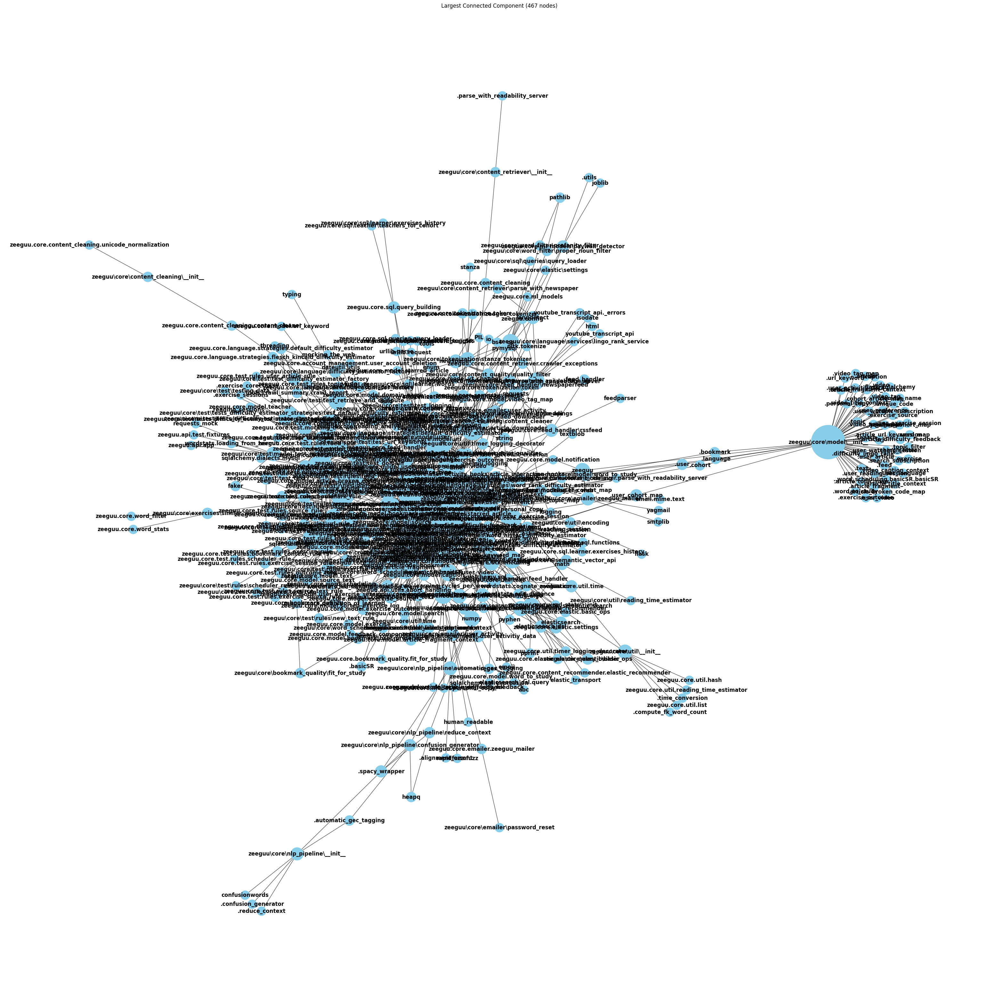

Graph saved to largest_component.png


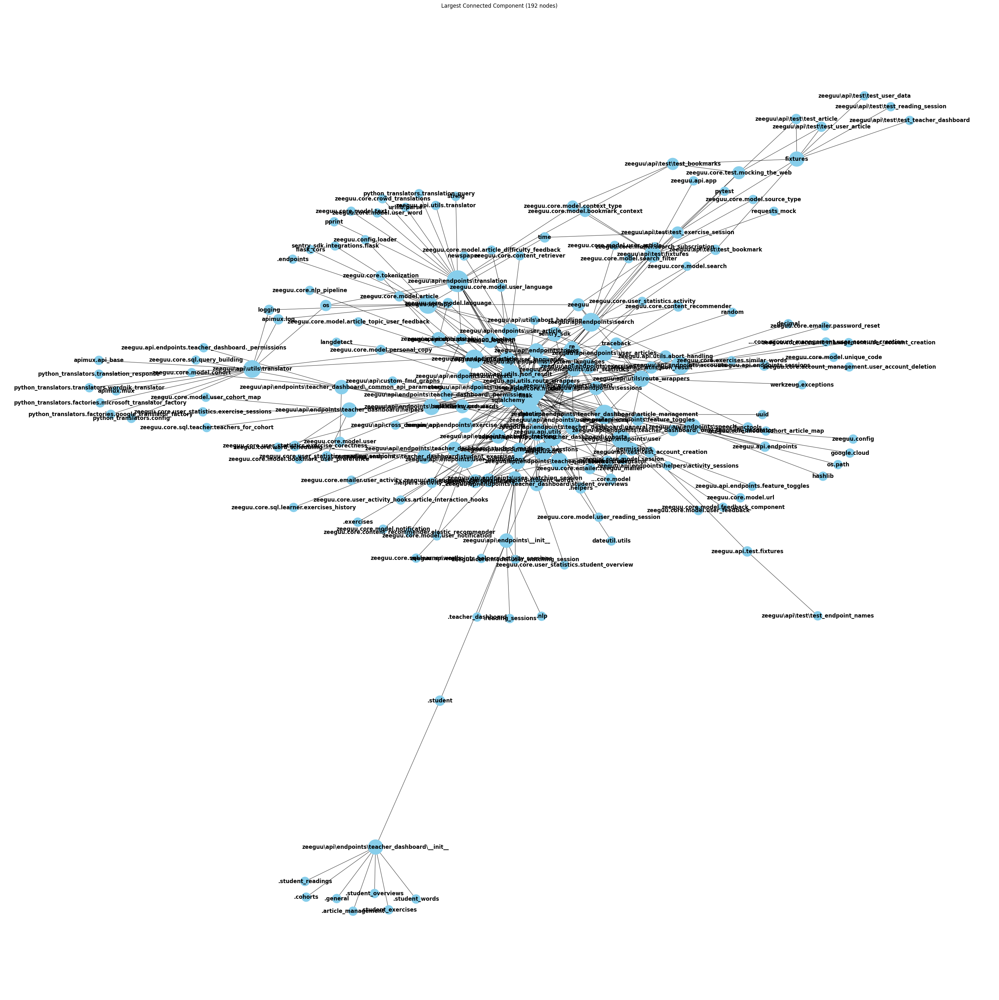

In [ ]:
G_CORE = dependencies_graph(CODE_ROOT_CORE)
# draw_graph(G_CORE, (40,40), with_labels=True)
draw_largest_connected_component(G_CORE, (40,40), "zeeguu-core-dependency-graph")
G_API = dependencies_graph(CODE_ROOT_API)
# draw_graph(G_API, (40,40), with_labels=True)
draw_largest_connected_component(G_API, (40,40), "zeeguu-api-dependency-graph")

In [ ]:
# However, if we think a bit more about it, we realize tat a dependency graph
# is a directed graph (e.g. module A depends on m)
# with any kinds of graph either directed (nx.DiGraph) or
# non-directed (nx.Graph)

def dependencies_digraph(code_root_folder):
    files = Path(code_root_folder).rglob("*.py")

    G = nx.DiGraph()

    for file in files:
        file_path = str(file)

        source_module = module_name_from_file_path(file_path)

        if source_module not in G.nodes:
            G.add_node(source_module)

        for target_module in imports_from_file(file_path):

            G.add_edge(source_module, target_module)
            # print(module_name + "=>" + each + ".")

    return G


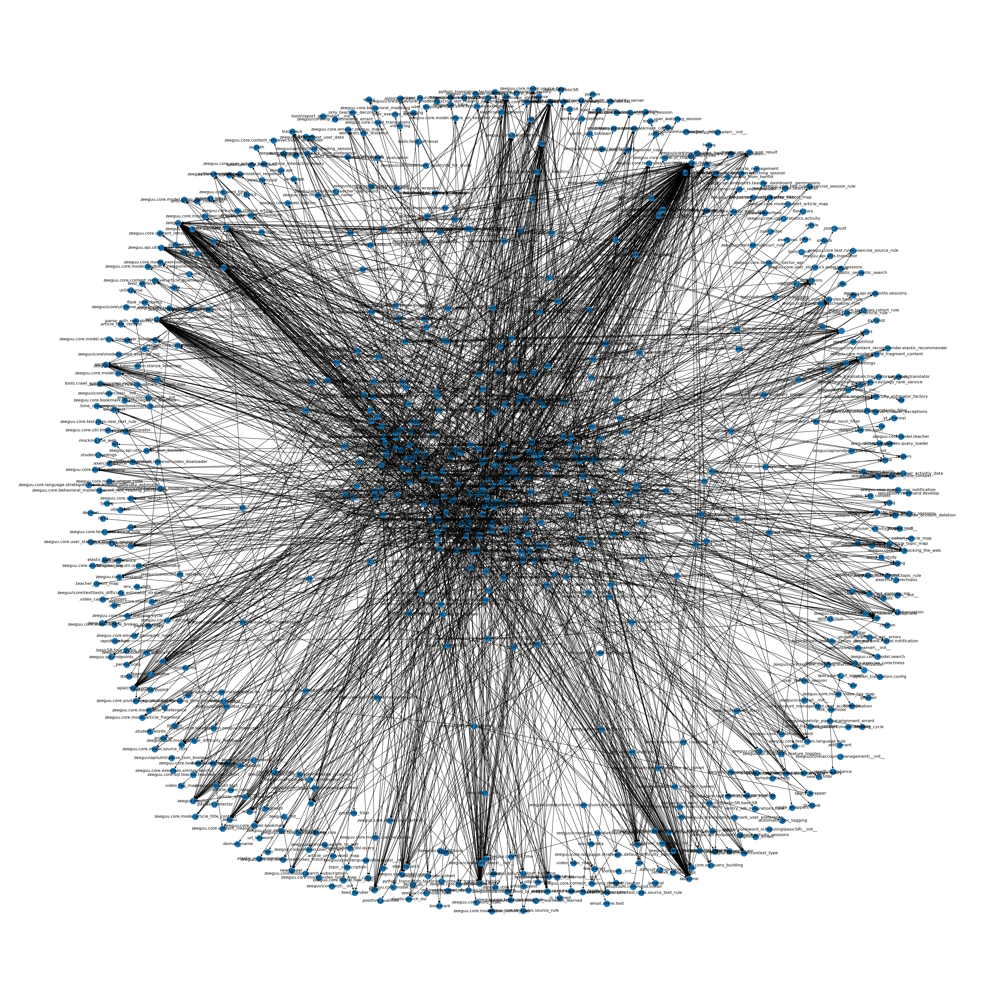

In [ ]:
# Looking at the directed graph
DG = dependencies_digraph(CODE_ROOT_FOLDER)
draw_graph(DG, (40,40), with_labels=True)

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np
import community as community_louvain
from collections import Counter
import pandas as pd
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap

class GraphAnalysisToolkit:
    """
    A toolkit for analyzing and visualizing large graphs to understand system architecture.
    """
    
    def __init__(self, graph):
        """Initialize with a networkx graph."""
        self.graph = graph
        self.largest_component = None
        self.communities = None
        self.community_graph = None
        self.metrics = {}
        
    def extract_largest_component(self):
        """Extract and return the largest connected component."""
        if not nx.is_connected(self.graph):
            components = list(nx.connected_components(self.graph))
            largest_component = max(components, key=len)
            self.largest_component = self.graph.subgraph(largest_component).copy()
            print(f"Extracted largest component with {len(largest_component)} nodes "
                  f"({len(largest_component)/self.graph.number_of_nodes()*100:.1f}% of total)")
        else:
            self.largest_component = self.graph.copy()
            print("Graph is already connected")
        return self.largest_component
        
    def compute_metrics(self):
        """Compute various graph metrics to understand the structure."""
        G = self.largest_component or self.graph
        
        # Basic metrics
        self.metrics['node_count'] = G.number_of_nodes()
        self.metrics['edge_count'] = G.number_of_edges()
        self.metrics['density'] = nx.density(G)
        
        # Get degree information
        degrees = dict(G.degree())
        self.metrics['avg_degree'] = sum(degrees.values()) / len(degrees)
        self.metrics['max_degree'] = max(degrees.values())
        
        # Top hubs (high degree nodes)
        sorted_degrees = sorted(degrees.items(), key=lambda x: x[1], reverse=True)
        self.metrics['top_hubs'] = sorted_degrees[:10]
        
        # Centrality metrics
        print("Computing betweenness centrality (may take time)...")
        if G.number_of_nodes() > 1000:
            # For large graphs, use approximate betweenness on a sample of nodes
            betweenness = nx.betweenness_centrality(G, k=min(500, G.number_of_nodes()))
        else:
            betweenness = nx.betweenness_centrality(G)
        
        self.metrics['betweenness_centrality'] = sorted(betweenness.items(), 
                                                       key=lambda x: x[1], 
                                                       reverse=True)[:10]
        
        # Clustering
        self.metrics['clustering_coefficient'] = nx.average_clustering(G)
        
        # Path length (if computationally feasible)
        if G.number_of_nodes() <= 1000:
            try:
                self.metrics['avg_shortest_path'] = nx.average_shortest_path_length(G)
            except:
                self.metrics['avg_shortest_path'] = "Not computable (not connected)"
        else:
            self.metrics['avg_shortest_path'] = "Skipped (graph too large)"
            
        return self.metrics
    
    def detect_communities(self, resolution=1.0):
        """Detect communities using Louvain method."""
        G = self.largest_component or self.graph
        
        print("Detecting communities...")
        # Convert to undirected if directed
        if G.is_directed():
            G_undir = G.to_undirected()
        else:
            G_undir = G
            
        # Detect communities
        partition = community_louvain.best_partition(G_undir, resolution=resolution)
        self.communities = partition
        
        # Count communities
        community_counts = Counter(partition.values())
        
        print(f"Detected {len(community_counts)} communities")
        print("Top 5 communities by size:")
        for comm_id, count in community_counts.most_common(5):
            print(f"  Community {comm_id}: {count} nodes ({count/G.number_of_nodes()*100:.1f}%)")
            
        return partition
    
    def create_community_graph(self):
        """Create a graph of communities."""
        if not self.communities:
            print("Run detect_communities() first")
            return None
            
        G = self.largest_component or self.graph
        
        # Create a new graph where nodes are communities
        comm_graph = nx.Graph()
        
        # Add community nodes
        for comm_id in set(self.communities.values()):
            # Size = number of nodes in community
            size = list(self.communities.values()).count(comm_id)
            comm_graph.add_node(comm_id, size=size)
        
        # Add edges between communities that have connections
        for u, v in G.edges():
            comm_u = self.communities[u]
            comm_v = self.communities[v]
            if comm_u != comm_v:
                if comm_graph.has_edge(comm_u, comm_v):
                    comm_graph[comm_u][comm_v]['weight'] += 1
                else:
                    comm_graph.add_edge(comm_u, comm_v, weight=1)
        
        self.community_graph = comm_graph
        return comm_graph
    
    def visualize_largest_component(self, save_path="largest_component.png", dpi=300):
        """Visualize the largest connected component with node sizes by degree."""
        if self.largest_component is None:
            self.extract_largest_component()
            
        G = self.largest_component
        
        # If still too large, consider sampling
        if G.number_of_nodes() > 500:
            print(f"Warning: Graph is large ({G.number_of_nodes()} nodes). "
                  f"Consider using community visualization instead.")
        
        # Calculate node sizes based on degree
        degrees = dict(G.degree())
        node_sizes = [50 + 10 * degrees[node] for node in G.nodes()]
        
        # Calculate node colors based on betweenness centrality
        print("Computing centrality for colors...")
        if G.number_of_nodes() > 1000:
            betweenness = nx.betweenness_centrality(G, k=100)  # Approximate
        else:
            betweenness = nx.betweenness_centrality(G)
            
        node_colors = [betweenness[node] for node in G.nodes()]
        
        # Compute layout (force-directed)
        print("Computing layout...")
        if G.number_of_nodes() > 1000:
            pos = nx.spring_layout(G, k=0.3, iterations=50)
        else:
            pos = nx.spring_layout(G, k=0.3, iterations=100)
        
        # Draw the graph
        plt.figure(figsize=(12, 10))
        nx.draw_networkx_nodes(G, pos, 
                              node_size=node_sizes,
                              node_color=node_colors, 
                              cmap=plt.cm.viridis,
                              alpha=0.8)
        
        nx.draw_networkx_edges(G, pos, alpha=0.2)
        
        # Only label nodes with high degrees
        threshold = np.percentile(list(degrees.values()), 95)
        labels = {node: str(node) for node in G.nodes() if degrees[node] >= threshold}
        nx.draw_networkx_labels(G, pos, labels=labels, font_size=8)
        
        plt.title(f"Largest Component: {G.number_of_nodes()} nodes, {G.number_of_edges()} edges")
        plt.axis('off')
        
        # Add a colorbar to indicate betweenness
        sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis)
        sm.set_array(node_colors)
        # plt.colorbar(sm, label="Betweenness Centrality")
        
        plt.savefig(save_path, dpi=dpi, bbox_inches='tight')
        print(f"Graph saved to {save_path}")
        plt.show()
        
    def visualize_communities(self, save_path="community_visualization.png", dpi=300):
        """Visualize communities in the largest component."""
        if not self.communities:
            print("Run detect_communities() first")
            return
            
        G = self.largest_component or self.graph
        
        # Compute layout
        print("Computing layout for community visualization...")
        if G.number_of_nodes() > 1000:
            pos = nx.spring_layout(G, k=0.3, iterations=50, seed=42)
        else:
            pos = nx.spring_layout(G, k=0.3, iterations=100, seed=42)
        
        # Create figure
        plt.figure(figsize=(14, 12))
        
        # Get unique community IDs
        community_ids = set(self.communities.values())
        
        # Create a colormap with enough colors
        cmap = plt.cm.get_cmap('tab20', len(community_ids))
        
        # Draw nodes colored by community
        for i, community in enumerate(community_ids):
            node_list = [node for node in G.nodes() if self.communities[node] == community]
            nx.draw_networkx_nodes(G, pos, 
                                  nodelist=node_list,
                                  node_color=[cmap(community)],
                                  node_size=60,
                                  label=f"Community {community}")
        
        # Draw edges with low alpha for clarity
        nx.draw_networkx_edges(G, pos, alpha=0.1)
        
        # Draw labels for nodes with high degree
        degrees = dict(G.degree())
        threshold = np.percentile(list(degrees.values()), 98)  # Top 2%
        labels = {node: str(node) for node in G.nodes() if degrees[node] >= threshold}
        nx.draw_networkx_labels(G, pos, labels=labels, font_size=8)
        
        plt.title(f"Community Structure: {len(community_ids)} communities")
        plt.axis('off')
        
        # Add legend with top 5 communities by size
        comm_sizes = Counter(self.communities.values())
        legend_labels = []
        for comm_id, count in comm_sizes.most_common(5):
            legend_labels.append(f"Community {comm_id}: {count} nodes")
            
        plt.legend(legend_labels, loc='upper right', bbox_to_anchor=(1.1, 1))
        
        plt.savefig(save_path, dpi=dpi, bbox_inches='tight')
        print(f"Community visualization saved to {save_path}")
        plt.show()
        
    def visualize_community_graph(self, save_path="community_graph.png", dpi=300):
        """Visualize the graph of communities."""
        if self.community_graph is None:
            self.create_community_graph()
            
        G = self.community_graph
        
        # Compute positions using spring layout
        pos = nx.spring_layout(G, k=0.5, iterations=100, seed=42)
        
        # Node sizes based on community size
        node_sizes = [300 * G.nodes[node]['size'] / max(nx.get_node_attributes(G, 'size').values())
                     for node in G.nodes()]
        
        # Edge weights
        edge_weights = [G[u][v]['weight'] for u, v in G.edges()]
        max_weight = max(edge_weights) if edge_weights else 1
        edge_widths = [0.5 + 3.0 * (w / max_weight) for w in edge_weights]
        
        # Create figure
        plt.figure(figsize=(12, 10))
        
        # Draw the graph
        cmap = plt.cm.viridis
        nodes = nx.draw_networkx_nodes(G, pos, 
                                      node_size=node_sizes, 
                                      node_color=list(G.nodes()),
                                      cmap=cmap)
                                      
        edges = nx.draw_networkx_edges(G, pos, 
                                      width=edge_widths, 
                                      alpha=0.7, 
                                      edge_color='gray')
                                      
        # Add labels
        labels = {node: f"C{node}" for node in G.nodes()}
        nx.draw_networkx_labels(G, pos, labels=labels)
        
        # Add edge labels for significant connections
        edge_labels = {(u, v): G[u][v]['weight'] for u, v in G.edges() 
                      if G[u][v]['weight'] > max_weight * 0.3}
        nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=8)
        
        plt.title("Community Interaction Graph")
        plt.axis('off')
        
        plt.savefig(save_path, dpi=dpi, bbox_inches='tight')
        print(f"Community graph saved to {save_path}")
        plt.show()
        
    def plot_degree_distribution(self, save_path="degree_distribution.png", dpi=300):
        """Plot the degree distribution to identify hubs."""
        G = self.largest_component or self.graph
        
        degrees = [d for _, d in G.degree()]
        
        plt.figure(figsize=(10, 6))
        
        # Create histogram
        plt.hist(degrees, bins=30, alpha=0.7, color='skyblue')
        
        # Add log-log plot inset for power-law check
        ax_inset = plt.axes([0.55, 0.55, 0.35, 0.35])
        degree_counts = Counter(degrees)
        x = sorted(degree_counts.keys())
        y = [degree_counts[d] for d in x]
        
        ax_inset.loglog(x, y, 'o-', markersize=3, linewidth=1)
        ax_inset.set_title('Log-Log Plot', fontsize=10)
        ax_inset.set_xlabel('Degree (log)', fontsize=8)
        ax_inset.set_ylabel('Count (log)', fontsize=8)
        ax_inset.tick_params(axis='both', which='major', labelsize=6)
        
        plt.xlabel('Node Degree')
        plt.ylabel('Frequency')
        plt.title('Degree Distribution')
        
        plt.savefig(save_path, dpi=dpi, bbox_inches='tight')
        print(f"Degree distribution saved to {save_path}")
        plt.show()
        
    def hub_analysis(self, top_n=20):
        """Analyze the top hubs in the network."""
        G = self.largest_component or self.graph
        
        # Get degree centrality
        degree = dict(G.degree())
        
        # Get betweenness centrality (for a sample if large)
        if G.number_of_nodes() > 1000:
            betweenness = nx.betweenness_centrality(G, k=500)
        else:
            betweenness = nx.betweenness_centrality(G)
            
        # Get closeness centrality (for a sample if large)
        if G.number_of_nodes() > 1000:
            # Sample nodes for efficiency
            sample_nodes = list(G.nodes())[:500]
            closeness = nx.closeness_centrality(G, nbunch=sample_nodes)
        else:
            closeness = nx.closeness_centrality(G)
        
        # Combine metrics
        hub_data = []
        for node in G.nodes():
            hub_data.append({
                'node': node,
                'degree': degree[node],
                'betweenness': betweenness[node],
                'closeness': closeness.get(node, 0)  # Use 0 if not in sample
            })
        
        # Convert to DataFrame
        hub_df = pd.DataFrame(hub_data)
        
        # Sort by degree
        hub_df = hub_df.sort_values('degree', ascending=False).head(top_n)
        
        # Calculate normalized metrics for visualization
        for col in ['degree', 'betweenness', 'closeness']:
            if hub_df[col].max() > 0:  # Avoid division by zero
                hub_df[f'{col}_norm'] = hub_df[col] / hub_df[col].max()
            else:
                hub_df[f'{col}_norm'] = 0
                
        return hub_df
        
    def visualize_hub_analysis(self, top_n=20, save_path="hub_analysis.png", dpi=300):
        """Visualize hub analysis as a heatmap."""
        hub_df = self.hub_analysis(top_n)
        
        plt.figure(figsize=(12, 8))
        
        # Create a visualization showing the metrics
        metrics = ['degree_norm', 'betweenness_norm', 'closeness_norm']
        
        # Create a custom colormap from white to deep blue
        colors = [(1, 1, 1), (0.1, 0.3, 0.8)]  # White to blue
        cmap = LinearSegmentedColormap.from_list('WhiteToBlue', colors, N=100)
        
        # Plot heatmap
        sns.heatmap(hub_df[metrics].set_index(hub_df['node']), 
                   cmap=cmap, 
                   linewidths=0.5,
                   linecolor='lightgray',
                   cbar_kws={'label': 'Normalized Value'})
                   
        plt.title(f'Top {top_n} Hub Analysis')
        plt.ylabel('Node ID')
        
        # Convert column names for display
        plt.xticks([0.5, 1.5, 2.5], ['Degree', 'Betweenness', 'Closeness'], 
                  rotation=0)
        
        plt.tight_layout()
        plt.savefig(save_path, dpi=dpi, bbox_inches='tight')
        print(f"Hub analysis saved to {save_path}")
        plt.show()
        
        return hub_df
        
    def find_bridges_and_bottlenecks(self):
        """Find critical bridges and bottlenecks in the network."""
        G = self.largest_component or self.graph
        
        # Find bridges (edges that would disconnect the graph if removed)
        print("Finding bridges...")
        bridges = list(nx.bridges(G))
        
        # Find articulation points (nodes that would disconnect the graph if removed)
        print("Finding articulation points...")
        articulation_points = list(nx.articulation_points(G))
        
        print(f"Found {len(bridges)} bridges and {len(articulation_points)} articulation points")
        
        # If there are too many, limit the output
        if len(bridges) > 10:
            print(f"Top 10 bridges (out of {len(bridges)}):")
            bridges = bridges[:10]
        
        if len(articulation_points) > 10:
            print(f"Top 10 articulation points (out of {len(articulation_points)}):")
            articulation_points = list(articulation_points)[:10]
            
        return {
            'bridges': bridges,
            'articulation_points': articulation_points
        }
        
    def visualize_system_architecture(self, save_path="system_architecture.png", dpi=300):
        """Create a high-level visualization of the system architecture."""
        if not self.communities:
            self.detect_communities()
            
        if self.community_graph is None:
            self.create_community_graph()
        
        # Create a figure
        plt.figure(figsize=(16, 12))
        
        # Get the community graph
        G = self.community_graph
        
        # Compute layout
        pos = nx.spring_layout(G, k=1.5, iterations=100, seed=42)
        
        # Node sizes based on community size (with minimum size)
        sizes = nx.get_node_attributes(G, 'size')
        max_size = max(sizes.values())
        node_sizes = {node: 1000 * (sizes[node] / max_size) + 500 for node in G.nodes()}
        
        # Edge widths based on number of interconnections
        edge_widths = {(u, v): 1 + 3 * G[u][v]['weight'] / max([G[a][b]['weight'] for a, b in G.edges()]) 
                      for u, v in G.edges()}
        
        # Create a custom colormap
        colors = plt.cm.tab20(np.linspace(0, 1, len(G.nodes())))
        
        # Draw nodes
        for i, node in enumerate(G.nodes()):
            nx.draw_networkx_nodes(G, pos, 
                                  nodelist=[node],
                                  node_size=node_sizes[node],
                                  node_color=[colors[i]],
                                  alpha=0.8)
        
        # Draw edges with width based on weight
        for u, v in G.edges():
            nx.draw_networkx_edges(G, pos, 
                                  edgelist=[(u, v)],
                                  width=edge_widths[(u, v)],
                                  alpha=0.6,
                                  edge_color='gray')
        
        # Node labels
        labels = {}
        for node in G.nodes():
            # Get some significant nodes in this community
            community_nodes = [n for n, comm in self.communities.items() if comm == node]
            
            # Get high-degree nodes in this community
            degrees = {n: self.largest_component.degree(n) for n in community_nodes 
                      if n in self.largest_component}
            top_nodes = sorted(degrees.items(), key=lambda x: x[1], reverse=True)[:3]
            
            # Create label with top nodes
            if top_nodes:
                top_node_str = ", ".join(str(n) for n, _ in top_nodes)
                labels[node] = f"C{node}\n({len(community_nodes)} nodes)\nKey: {top_node_str}"
            else:
                labels[node] = f"C{node}\n({len(community_nodes)} nodes)"
                
        nx.draw_networkx_labels(G, pos, labels=labels, font_size=10)
        
        # Edge labels for significant connections
        edge_labels = {}
        max_weight = max(G[u][v]['weight'] for u, v in G.edges())
        for u, v in G.edges():
            if G[u][v]['weight'] > max_weight * 0.2:  # Only label significant edges
                edge_labels[(u, v)] = G[u][v]['weight']
                
        nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=8)
        
        plt.title("System Architecture: Community-Level View", fontsize=16)
        plt.axis('off')
        
        plt.savefig(save_path, dpi=dpi, bbox_inches='tight')
        print(f"System architecture visualization saved to {save_path}")
        plt.show()
        
    def generate_analysis_report(self):
        """Generate a comprehensive analysis report of the graph structure."""
        # Make sure we have all required data
        if self.largest_component is None:
            self.extract_largest_component()
            
        if not self.metrics:
            self.compute_metrics()
            
        if not self.communities:
            self.detect_communities()
            
        if self.community_graph is None:
            self.create_community_graph()
            
        # Get hub analysis
        hub_df = self.hub_analysis(top_n=10)
        
        # Find bridges and bottlenecks
        critical_elements = self.find_bridges_and_bottlenecks()
        
        # Generate report
        report = {}
        
        # Basic statistics
        report['basic_stats'] = {
            'total_nodes': self.graph.number_of_nodes(),
            'total_edges': self.graph.number_of_edges(),
            'largest_component_nodes': self.largest_component.number_of_nodes(),
            'largest_component_edges': self.largest_component.number_of_edges(),
            'density': self.metrics['density'],
            'avg_degree': self.metrics['avg_degree'],
            'clustering_coefficient': self.metrics['clustering_coefficient']
        }
        
        # Community structure
        community_counts = Counter(self.communities.values())
        report['community_structure'] = {
            'num_communities': len(community_counts),
            'largest_community_size': max(community_counts.values()),
            'community_sizes': dict(community_counts)
        }
        
        # Major hubs
        report['major_hubs'] = hub_df[['node', 'degree', 'betweenness', 'closeness']].to_dict('records')
        
        # Critical elements (limit to top 5 for readability)
        report['critical_elements'] = {
            'bridges': critical_elements['bridges'][:5],
            'articulation_points': list(critical_elements['articulation_points'])[:5]
        }
        
        # Community interactions
        community_interactions = []
        for u, v in self.community_graph.edges():
            community_interactions.append({
                'community_1': u,
                'community_2': v,
                'connection_strength': self.community_graph[u][v]['weight']
            })
        
        report['community_interactions'] = sorted(
            community_interactions, 
            key=lambda x: x['connection_strength'], 
            reverse=True
        )[:10]  # Top 10 interactions
        
        return report

# Example usage
def analyze_system_architecture(graph):
    """Full pipeline for analyzing and visualizing a system architecture graph."""
    
    analyzer = GraphAnalysisToolkit(graph)
    
    # Extract largest component
    analyzer.extract_largest_component()
    
    # Compute metrics
    metrics = analyzer.compute_metrics()
    print("\nGraph Metrics:")
    print(f"Nodes: {metrics['node_count']}")
    print(f"Edges: {metrics['edge_count']}")
    print(f"Density: {metrics['density']:.6f}")
    print(f"Average Degree: {metrics['avg_degree']:.2f}")
    print(f"Clustering Coefficient: {metrics['clustering_coefficient']:.4f}")
    
    print("\nTop 5 Hubs:")
    for node, degree in metrics['top_hubs'][:5]:
        print(f"  Node {node}: {degree} connections")
    
    # Detect communities
    analyzer.detect_communities()
    
    # Create visualizations
    analyzer.visualize_largest_component(save_path="largest_component.png")
    analyzer.visualize_communities(save_path="communities.png")
    analyzer.create_community_graph()
    analyzer.visualize_community_graph(save_path="community_graph.png")
    analyzer.plot_degree_distribution(save_path="degree_distribution.png")
    analyzer.visualize_hub_analysis(save_path="hub_analysis.png")
    analyzer.visualize_system_architecture(save_path="system_architecture.png")
    
    # Generate and return analysis report
    report = analyzer.generate_analysis_report()
    return analyzer, report

# Usage example:
# import networkx as nx
# G = nx.read_graphml("my_system_graph.graphml")  # or any other graph loading method
analyzer, report = analyze_system_architecture(G_CORE)

In [99]:

# Let's define some relevant modules
def relevant_module(module_name):

  if "test" in module_name:
    return False


  if module_name.startswith("zeeguu"):
    return True


  return False

In [100]:
# However, if we think a bit more about it, we realize that a dependency graph
# is a directed graph (e.g. module A depends on m)
# with any kinds of graph either directed (nx.DiGraph) or
# non-directed (nx.Graph)

def dependencies_digraph(code_root_folder):
    files = Path(code_root_folder).rglob("*.py")

    G = nx.DiGraph()

    for file in files:
        file_path = str(file)

        source_module = module_name_from_file_path(file_path)
        if not relevant_module(source_module):
          continue

        if source_module not in G.nodes:
            G.add_node(source_module)

        for target_module in imports_from_file(file_path):

            if relevant_module(target_module):
              G.add_edge(source_module, target_module)


    return G


In [101]:
# extracts the parent of depth X
def top_level_package(module_name, depth=1):
    components = module_name.split(".")
    return ".".join(components[:depth])

assert (top_level_package("zeeguu.core.model.util", 1) == "zeeguu")
assert (top_level_package("zeeguu.core.model.util", 2) == "zeeguu.core")

def abstracted_to_top_level(G, depth=1):
    aG = nx.DiGraph()
    for each in G.edges():
        src = top_level_package(each[0], depth)
        dst = top_level_package(each[1], depth)

        if src != dst:
          aG.add_edge(src, dst)

    return aG


Graph saved to ADG-API-abstracted-diagram


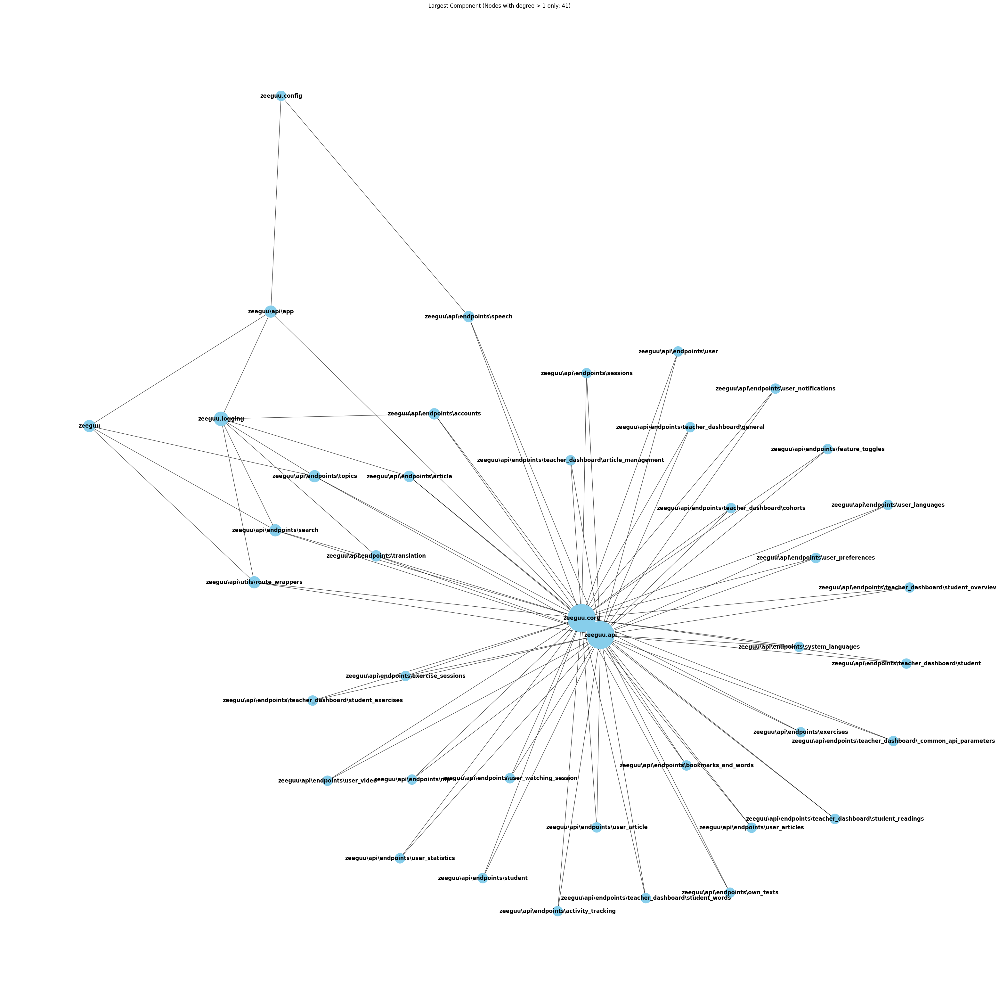

Graph saved to ADG-CORE-abstracted-diagram


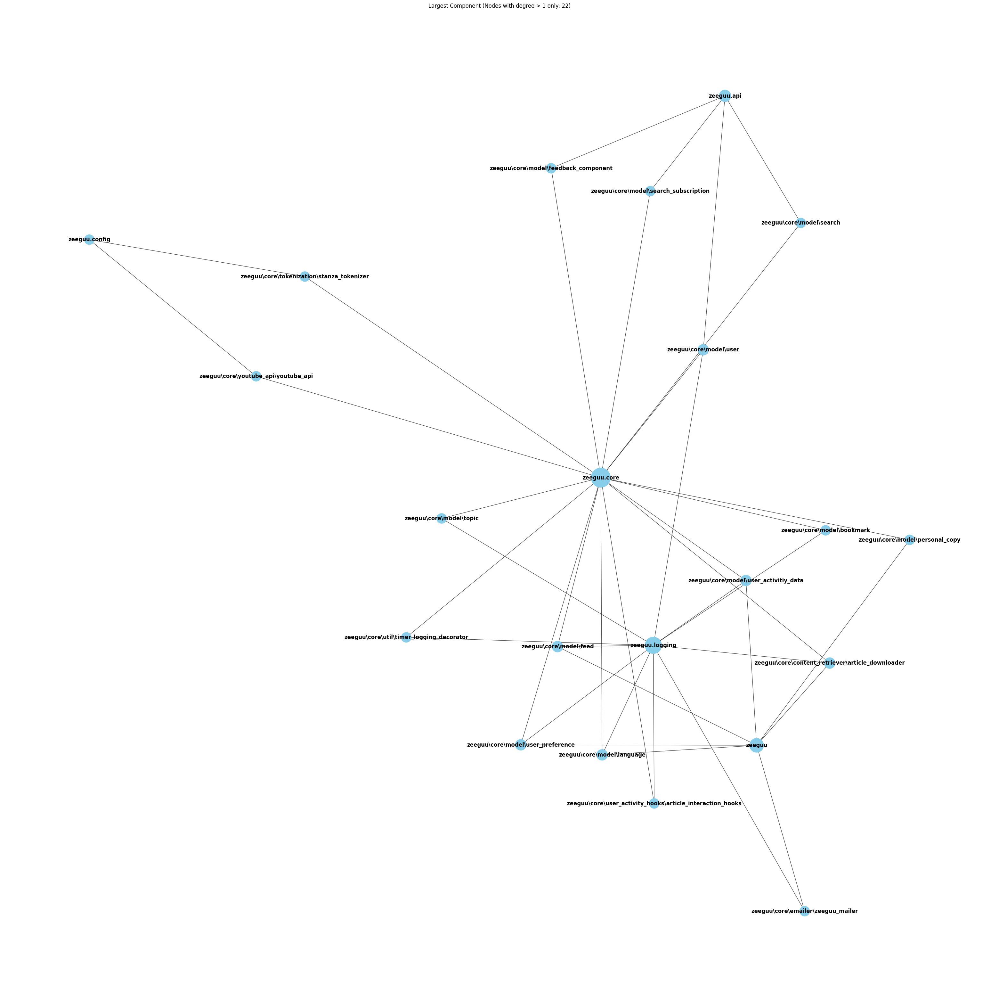

In [105]:

CODE_ROOT_CORE="/content/zeeguu-api/zeeguu/core/"
CODE_ROOT_API="/content/zeeguu-api/zeeguu/api/"
DG_CORE = dependencies_digraph(CODE_ROOT_CORE)
DG_API = dependencies_digraph(CODE_ROOT_API)
# draw_graph(DG_CORE, (40,40), with_labels=True)
# draw_graph(DG_API, (40,40), with_labels=True)
ADG_CORE = abstracted_to_top_level(DG_CORE,2)
ADG_API = abstracted_to_top_level(DG_API, 2)
# draw_graph(ADG_CORE, (8,8), with_labels=False)
# draw_graph(ADG_API, (8,8), with_labels=False)
draw_largest_connected_component(ADG_API.to_undirected(), (40,40), "ADG-API-abstracted-diagram", draw_labels=True)
draw_largest_connected_component(ADG_CORE.to_undirected(), (40,40), "ADG-CORE-abstracted-diagram", draw_labels=True)